# Visualizing Unstructrued Grids as Polygon Meshes

## Required Packages
```
conda install -c conda-forge uxarray
conda install -c conda-forge datashader holoviews geoviews
conda install -c pyviz spatialpandas
conda install -c conda-forge cmocean
conda install -c conda-forge pygeos 
conda install -c conda-forge pyarrow
conda install -c conda-forge hvplot
conda install selenium
conda install -c conda-forge firefox geckodriver

```

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import uxarray as ux

import dask as da
import dask.dataframe as dd
import multiprocessing as mp

import spatialpandas as sp
import spatialpandas.dask 
from spatialpandas.io import to_parquet, read_parquet

import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import rasterize
import datashader as ds
import datashader.transfer_functions as tf
import geoviews as gv
import geoviews.feature as gf

import hvplot.pandas  
import hvplot.xarray  
import hvplot.dask

from matplotlib import cm
import cartopy.crs as ccrs

In [2]:
import sys
%load_ext autoreload
%autoreload 2

#sys.path.insert(1, '/glade/u/home/philipc/geocat-internal-testing/siparcs-project-8/polyplot/')

from polymesh import polymesh as polymesh

## Loading Data with UXarray

In [3]:
# GeoFlow Small (6,000 nodes) or Large (6mil nodes)
#ds_base_path = "/glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/small/"
ds_base_path = "/glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/2D/"

# UXarray
ds_grid = ux.open_dataset(ds_base_path + "grid.nc",
                          ds_base_path + "v1.000000.nc",
                          ds_base_path + "v2.000000.nc",
                          ds_base_path + "v3.000000.nc",
                          ds_base_path + "d.000000.nc")

Loading initial grid from file:  /glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/2D/grid.nc


In [4]:
ds_grid.ds

<xarray.Dataset>
Dimensions:          (nMeshFaces: 3932160, nFaceNodes: 4, nMeshNodes: 6144000, time: 1)
Coordinates:
    mesh_node_x      (nMeshNodes) float64 ...
    mesh_node_y      (nMeshNodes) float64 ...
  * time             (time) float64 11.0
Dimensions without coordinates: nMeshFaces, nFaceNodes, nMeshNodes
Data variables:
    mesh             int32 ...
    mesh_face_nodes  (nMeshFaces, nFaceNodes) uint32 ...
    mesh_depth       (nMeshNodes) float64 ...
    d                (time, nMeshNodes) float64 dask.array<chunksize=(1, 6144000), meta=np.ndarray>
    v1               (time, nMeshNodes) float64 dask.array<chunksize=(1, 6144000), meta=np.ndarray>
    v2               (time, nMeshNodes) float64 dask.array<chunksize=(1, 6144000), meta=np.ndarray>
    v3               (time, nMeshNodes) float64 dask.array<chunksize=(1, 6144000), meta=np.ndarray>
Attributes:
    history:  Sun Nov 14 10:29:42 2021: ncwa -a meshLayers grid.nc ../grid.nc
    NCO:      netCDF Operators version 5.0.0 (Homepage = http://nco.sf.net, C...

## Constructing a Polygon Mesh with `polymesh`

In [10]:
%%time
projection = ccrs.Robinson()
geoflow = polymesh(ds=ds_grid, projection=projection)

CPU times: user 11.7 s, sys: 727 ms, total: 12.4 s
Wall time: 12.8 s


In [13]:
%%time
#df = geoflow.data_mesh(name="v2", dims={"time" : 0, "meshLayers" : 0}, method="Mean")
df = geoflow.data_mesh(name="v1", dims={"time" : 0}, method="Mean")

CPU times: user 135 ms, sys: 36.6 ms, total: 172 ms
Wall time: 227 ms


In [7]:
df

,geometry,faces
0,"MultiPolygon([[[0.0, 8600463.593830053, 253439...",1.049615
1,"MultiPolygon([[[253439.50391282892, 8601941.21...",1.351950
2,"MultiPolygon([[[813621.0009876577, 8604112.650...",2.041679
3,"MultiPolygon([[[1463059.1846287327, 8605287.32...",2.704981
4,"MultiPolygon([[[0.0, 8602734.125266489, 260180...",1.050735
...,...,...
3934263,"MultiPolygon([[[16471740.606506817, -2876899.2...",5.417220
3934264,"MultiPolygon([[[-16477314.835937155, -2862762....",5.427984
3934265,"MultiPolygon([[[16477314.835937155, -2862762.9...",5.427984
3934266,"MultiPolygon([[[-16482835.42762871, -2848626.7...",5.436205


## Method 1: Using `hvPlot` and `Geoviews` 

In [8]:
hv.output(fig='svg')

Error: Value 'svg' for key 'fig' not one of ['html', 'auto', 'png']
For help with hv.util.output call help(hv.util.output)


:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]
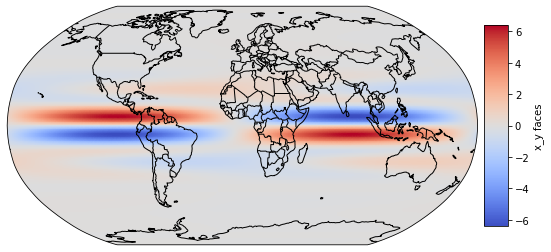

In [14]:
# Use Matplotlib backend and select color map
hvplot.extension('matplotlib')
cmap = cm.coolwarm

# Create a rasterized plot of our Polygons (Matplotlib Style)
out = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)
out

# Export and Save Plot
#hv.save(out, "../plots/poly-mesh-v1.png", dpi=200)

In [15]:
# Use Matplotlib backend and select color map
hvplot.extension('bokeh')
cmap = cm.coolwarm

# Create a rasterized plot of our Polygons (Matplotlib Style)
df.hvplot.polygons(rasterize=True, width=1000, height=500, c='faces', cmap=cmap) * gf.coastline(projection=projection)

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]

# Method 2: Using `Datashader` and `Dask` to create rasterized plots

In [ ]:
%%time
df.astype('float32').dtypes 
to_parquet(df, 'world.parq')
df_p = read_parquet('world.parq')

In [ ]:
%%time
dask_df = dd.from_pandas(df_p, npartitions=mp.cpu_count())
dask_df.persist()

In [ ]:
# Use Matplotlib backend and select color map
hvplot.extension('matplotlib')
cmap = cm.coolwarm

# Create a HoloViews Polygon Object
hvpolys = hv.Polygons(dask_df, vdims=['faces']).opts(color='faces')

# Rasterize our Polygon Mesh
rasterize(hvpolys, aggregator=ds.mean('faces')).opts(fig_size=400, cmap=cmap, colorbar=True, 
                                                     title="Filled Polygon Mesh") * gf.coastline(projection=projection) * gf.borders(projection=projection)

In [ ]:
# Use Bokeh backend and select color map
hv.extension('bokeh')
cmap = cm.coolwarm

# Calculate Min and Max for Colorbar
c_min = dask_df['faces'].min().compute()
c_max = dask_df['faces'].max().compute()

hvpolys = hv.Polygons(dask_df, vdims=['faces']).opts(color='faces')
rasterize(hvpolys, aggregator=ds.mean('faces')).opts(width=1000,height=500, cmap=cmap, colorbar=True, 
                                                     title="Filled Polygon Mesh", tools=['hover'],
                                                     clim=(c_min, c_max))  * gf.coastline(projection=projection) * gf.borders(projection=projection)